In [1]:
from google.colab import files
files.upload()

Saving national-charge-point-registry.csv to national-charge-point-registry.csv


{'national-charge-point-registry.csv': b'chargeDeviceID,reference,name,latitude,longitude,subBuildingName,buildingName,buildingNumber,thoroughfare,street,doubleDependantLocality,dependantLocality,town,county,postcode,countryCode,uprn,deviceDescription,locationShortDescription,locationLongDescription,deviceManufacturer,deviceModel,deviceOwnerName,deviceOwnerWebsite,deviceOwnerTelephoneNo,deviceOwnerContactName,deviceControllerName,deviceControllerWebsite,deviceControllerTelephoneNo,deviceControllerContactName,deviceNetworks,chargeDeviceStatus,publishStatus,deviceValidated,dateCreated,dateUpdated,moderated,lastUpdated,lastUpdatedBy,attribution,dateDeleted,paymentRequired,paymentRequiredDetails,subscriptionRequired,subscriptionRequiredDetails,parkingFeesFlag,parkingFeesDetails,parkingFeesUrl,accessRestrictionFlag,accessRestrictionDetails,physicalRestrictionFlag,physicalRestrictionText,onStreetFlag,locationType,bearing,access24Hours,accessMondayFrom,accessMondayTo,accessTuesdayFrom,accessT

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
df = pd.read_csv("national-charge-point-registry.csv")

<ipython-input-3-d81eff42f378>:1: DtypeWarning: Columns (5,10,11,16,17,18,54,56,57,58,59,60,61,62,63,64,65,66,67,68,69,79,90,101,112,115,119,122,123,126,130,133,134,137,141,144,148,152,155) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv("national-charge-point-registry.csv")


In [4]:
df.head()

,chargeDeviceID,reference,name,latitude,longitude,subBuildingName,buildingName,buildingNumber,thoroughfare,street,...,connector8Type,connector8RatedOutputKW,connector8OutputCurrent,connector8RatedVoltage,connector8ChargeMethod,connector8ChargeMode,connector8TetheredCable,connector8Status,connector8Description,connector8Validated
0,c911241d00294e8bb714eee2e83fa475,PP-12289,Alex F Noble & Son,55.875053,-3.173333,NaN,NaN,NaN,NaN,Swinton Place,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,fa6c94460e902005a0b660266190c8ba,PP-12295,Ancaster Nissan Dealership,51.411173,-0.055369,NaN,NaN,61,Croydon Road,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,eb1848290d5a7de9c9ccabc67fefa211,PP-12290,Beadles Nissan Ltd,51.451127,0.050619,NaN,NaN,43-53,Eltham High Street,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,91e50fe1e39af2869d3336eaaeebdb43,PP-12292,Benfield Motors,54.978947,-1.599306,NaN,NaN,176,Portland Road,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,65b1e92c585fd4c2159d5f33b5030ff2,PP-12198,Circus Road,51.533633,-0.172353,NaN,NaN,NaN,Circus Road,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [5]:
df.info

<bound method DataFrame.info of                          chargeDeviceID       reference  \
0      c911241d00294e8bb714eee2e83fa475        PP-12289   
1      fa6c94460e902005a0b660266190c8ba        PP-12295   
2      eb1848290d5a7de9c9ccabc67fefa211        PP-12290   
3      91e50fe1e39af2869d3336eaaeebdb43        PP-12292   
4      65b1e92c585fd4c2159d5f33b5030ff2        PP-12198   
...                                 ...             ...   
31959  a016575ea129113c21a757ea84d8f86f  paul-bill-line   
31960  27d147324bce311bec043eda0e843298  wood-jack-role   
31961  875c5e2efc3b5ad3b9c890aa308bda56  east-game-star   
31962  4b3b38f40aadfedda73aff2e4ad53cce     Metric DC01   
31963  a9e59b70c78b7dc974b54af187d4383e     Metric DC02   

                             name   latitude  longitude subBuildingName  \
0              Alex F Noble & Son  55.875053  -3.173333             NaN   
1      Ancaster Nissan Dealership  51.411173  -0.055369             NaN   
2             Beadles Nissan Ltd  

In [6]:
l = df.isna().sum()

k = l[l.values > len(df["name"].values)*0.2].index

In [7]:
df.drop(k,axis = 1 ,inplace = True )

In [8]:
df.shape

(31964, 40)

In [9]:
df.head()

,chargeDeviceID,reference,name,latitude,longitude,town,county,postcode,countryCode,deviceOwnerName,...,connector1ID,connector1Type,connector1RatedOutputKW,connector1OutputCurrent,connector1RatedVoltage,connector1ChargeMethod,connector1ChargeMode,connector1TetheredCable,connector1Status,connector1Validated
0,c911241d00294e8bb714eee2e83fa475,PP-12289,Alex F Noble & Son,55.875053,-3.173333,Loanhead,Midlothian,EH20 9FB,gb,POD Point,...,6526.0,3-pin Type G (BS1363),3.0,13.0,230.0,Single Phase AC,1.0,0.0,In service,0.0
1,fa6c94460e902005a0b660266190c8ba,PP-12295,Ancaster Nissan Dealership,51.411173,-0.055369,Anerley,Greater London,SE20 7TF,gb,POD Point,...,6528.0,3-pin Type G (BS1363),3.0,13.0,230.0,Single Phase AC,1.0,0.0,In service,0.0
2,eb1848290d5a7de9c9ccabc67fefa211,PP-12290,Beadles Nissan Ltd,51.451127,0.050619,Eltham,Greater London,SE9 1DH,gb,POD Point,...,6532.0,3-pin Type G (BS1363),3.0,13.0,230.0,Single Phase AC,1.0,0.0,In service,0.0
3,91e50fe1e39af2869d3336eaaeebdb43,PP-12292,Benfield Motors,54.978947,-1.599306,Newcastle upon Tyne,Tyne and Wear,NE2 1AR,gb,POD Point,...,6534.0,3-pin Type G (BS1363),3.0,13.0,230.0,Single Phase AC,1.0,0.0,In service,0.0
4,65b1e92c585fd4c2159d5f33b5030ff2,PP-12198,Circus Road,51.533633,-0.172353,St. John's Wood,Greater London,NW8 6PE,gb,POD Point,...,6560.0,3-pin Type G (BS1363),3.0,13.0,230.0,Single Phase AC,1.0,0.0,In service,0.0


In [10]:
df.isna().sum()

chargeDeviceID                    0
reference                         2
name                              1
latitude                          2
longitude                         0
town                             11
county                         1957
postcode                          4
countryCode                       1
deviceOwnerName                   0
deviceOwnerWebsite                0
deviceOwnerTelephoneNo            0
deviceControllerName              0
deviceControllerWebsite           0
deviceControllerTelephoneNo       2
deviceNetworks                    0
chargeDeviceStatus                0
publishStatus                     0
deviceValidated                   0
dateCreated                       0
dateUpdated                       0
moderated                         0
attribution                       2
paymentRequired                   2
subscriptionRequired              2
parkingFeesFlag                   2
accessRestrictionFlag             2
physicalRestrictionFlag     

In [11]:
def continuous_var_summary(x):
    return pd.Series([x.count(), x.isnull().sum(), x.sum(), x.mean(), x.median(),
                      x.std(), x.var(), x.min(), x.quantile(0.01), x.quantile(0.05),
                          x.quantile(0.10),x.quantile(0.25),x.quantile(0.50),x.quantile(0.75),
                              x.quantile(0.90),x.quantile(0.95), x.quantile(0.99),x.max()],
                  index = ['N', 'NMISS', 'SUM', 'MEAN','MEDIAN', 'STD', 'VAR', 'MIN', 'P1',
                               'P5' ,'P10' ,'P25' ,'P50' ,'P75' ,'P90' ,'P95' ,'P99' ,'MAX'])

In [12]:
df.loc[:,(df.dtypes == 'float64') | (df.dtypes == 'int64')].apply(continuous_var_summary).T

,N,NMISS,SUM,MEAN,MEDIAN,STD,VAR,MIN,P1,P5,P10,P25,P50,P75,P90,P95,P99,MAX
latitude,31962.0,2.0,1.667472e+06,52.170455,51.529674,1.661931,2.762015e+00,-1.485505,50.627465,51.015621,51.099374,51.467521,51.529674,52.569615,54.517856,55.023967,56.373376,60.759109
longitude,31964.0,0.0,-3.322199e+04,-1.039357,-0.325763,1.560577,2.435400e+00,-60.953945,-5.917230,-3.837442,-2.854847,-1.748895,-0.325763,-0.156662,-0.054377,0.037403,1.152594,52.416177
deviceValidated,31964.0,0.0,6.400000e+01,0.002002,0.000000,0.253121,6.407008e-02,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,32.000000
paymentRequired,31962.0,2.0,1.428600e+04,0.446968,0.000000,0.497187,2.471954e-01,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000
subscriptionRequired,31962.0,2.0,7.722000e+03,0.241599,0.000000,0.428059,1.832349e-01,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000
parkingFeesFlag,31962.0,2.0,3.781000e+03,0.118297,0.000000,0.322964,1.043059e-01,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000
accessRestrictionFlag,31962.0,2.0,8.150000e+02,0.025499,0.000000,0.157638,2.484961e-02,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000
physicalRestrictionFlag,31369.0,595.0,1.518000e+03,0.048392,0.000000,0.214596,4.605143e-02,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000
access24Hours,29430.0,2534.0,2.843300e+04,0.966123,1.000000,0.180916,3.273046e-02,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
connector1ID,30611.0,1353.0,4.745102e+09,155012.965209,162255.000000,29614.463801,8.770165e+08,5757.000000,39506.100000,123120.000000,128930.000000,141586.000000,162255.000000,173540.500000,180527.000000,186959.500000,189050.800000,189641.000000


In [13]:
def categorical_var_summary(x):
    Mode = x.value_counts().sort_values(ascending = False)[0:1].reset_index()
    return pd.Series([x.count(), x.isnull().sum(), Mode.iloc[0, 0], Mode.iloc[0, 1],
                          round(Mode.iloc[0, 1] * 100/x.count(), 2)],
                  index = ['N', 'NMISS', 'MODE', 'FREQ', 'PERCENT'])

In [14]:
df.loc[:,(df.dtypes == 'object')].apply(categorical_var_summary)

,chargeDeviceID,reference,name,town,county,postcode,countryCode,deviceOwnerName,deviceOwnerWebsite,deviceOwnerTelephoneNo,...,chargeDeviceStatus,publishStatus,dateCreated,dateUpdated,moderated,attribution,locationType,connector1Type,connector1ChargeMethod,connector1Status
N,31964,31962,31963,31953,30007,31960,31963,31964,31964,31964,...,31964,31964,31964,31964,31964,31962,30611,30611,30611,30611
NMISS,0,2,1,11,1957,4,1,0,0,0,...,0,0,0,0,0,2,1353,1353,1353,1353
MODE,0df94ca5d0479fab1af38bc25e84e0bf,CM3229,London Road Car Park,London,Greater London,SP1 3HP,gb,*No Owner,http://www.national-charge-point-registry.uk/,No phone number,...,In service,Published,2015-07-09 13:22:03,2022-09-05 08:01:26,N,ubitricity,On-street,Type 2 Mennekes (IEC62196),Single Phase AC,In service
FREQ,1350,1350,1356,6957,6116,1352,31961,5857,5858,5857,...,31786,31962,1350,1350,22723,6022,12779,26376,22746,30438
PERCENT,4.22,4.22,4.24,21.77,20.38,4.23,99.99,18.32,18.33,18.32,...,99.44,99.99,4.22,4.22,71.09,18.84,41.75,86.17,74.31,99.43


Let's try the percentile methood to treat the outliers first

In [15]:
lower_limit = df.quantile(0.01)
upper_limit = df.quantile(0.99)
df1 = df[((df > lower_limit) | (df < upper_limit)).any(axis=1)]

<ipython-input-15-ebfbe3a8efb1>:1: FutureWarning: The default value of numeric_only in DataFrame.quantile is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  lower_limit = df.quantile(0.01)
<ipython-input-15-ebfbe3a8efb1>:2: FutureWarning: The default value of numeric_only in DataFrame.quantile is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  upper_limit = df.quantile(0.99)
<ipython-input-15-ebfbe3a8efb1>:3: FutureWarning: Automatic reindexing on DataFrame vs Series comparisons is deprecated and will raise ValueError in a future version. Do `left, right = left.align(right, axis=1, copy=False)` before e.g. `left == right`
  df1 = df[((df > lower_limit) | (df < upper_limit)).any(axis=1)]


In [16]:
df1.shape

(31964, 40)

In [17]:
df1.isna().sum()

chargeDeviceID                    0
reference                         2
name                              1
latitude                          2
longitude                         0
town                             11
county                         1957
postcode                          4
countryCode                       1
deviceOwnerName                   0
deviceOwnerWebsite                0
deviceOwnerTelephoneNo            0
deviceControllerName              0
deviceControllerWebsite           0
deviceControllerTelephoneNo       2
deviceNetworks                    0
chargeDeviceStatus                0
publishStatus                     0
deviceValidated                   0
dateCreated                       0
dateUpdated                       0
moderated                         0
attribution                       2
paymentRequired                   2
subscriptionRequired              2
parkingFeesFlag                   2
accessRestrictionFlag             2
physicalRestrictionFlag     

In [18]:
df1.loc[:,(df1.dtypes == 'float64') | (df1.dtypes == 'int64')].apply(continuous_var_summary).T

,N,NMISS,SUM,MEAN,MEDIAN,STD,VAR,MIN,P1,P5,P10,P25,P50,P75,P90,P95,P99,MAX
latitude,31962.0,2.0,1.667472e+06,52.170455,51.529674,1.661931,2.762015e+00,-1.485505,50.627465,51.015621,51.099374,51.467521,51.529674,52.569615,54.517856,55.023967,56.373376,60.759109
longitude,31964.0,0.0,-3.322199e+04,-1.039357,-0.325763,1.560577,2.435400e+00,-60.953945,-5.917230,-3.837442,-2.854847,-1.748895,-0.325763,-0.156662,-0.054377,0.037403,1.152594,52.416177
deviceValidated,31964.0,0.0,6.400000e+01,0.002002,0.000000,0.253121,6.407008e-02,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,32.000000
paymentRequired,31962.0,2.0,1.428600e+04,0.446968,0.000000,0.497187,2.471954e-01,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000
subscriptionRequired,31962.0,2.0,7.722000e+03,0.241599,0.000000,0.428059,1.832349e-01,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000
parkingFeesFlag,31962.0,2.0,3.781000e+03,0.118297,0.000000,0.322964,1.043059e-01,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000
accessRestrictionFlag,31962.0,2.0,8.150000e+02,0.025499,0.000000,0.157638,2.484961e-02,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000
physicalRestrictionFlag,31369.0,595.0,1.518000e+03,0.048392,0.000000,0.214596,4.605143e-02,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000
access24Hours,29430.0,2534.0,2.843300e+04,0.966123,1.000000,0.180916,3.273046e-02,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
connector1ID,30611.0,1353.0,4.745102e+09,155012.965209,162255.000000,29614.463801,8.770165e+08,5757.000000,39506.100000,123120.000000,128930.000000,141586.000000,162255.000000,173540.500000,180527.000000,186959.500000,189050.800000,189641.000000


Since we havn't resolved so we'll use the standard deviation method next to treat them

In [19]:
mean = df.mean()
std = df.std()
cut_off = std * 3
lower, upper = mean - cut_off, mean + cut_off
df3 = df[~((df < lower) | (df > upper)).any(axis=1)]

<ipython-input-19-62b711a93cc1>:1: FutureWarning: The default value of numeric_only in DataFrame.mean is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.
  mean = df.mean()
<ipython-input-19-62b711a93cc1>:2: FutureWarning: The default value of numeric_only in DataFrame.std is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.
  std = df.std()
<ipython-input-19-62b711a93cc1>:5: FutureWarning: Automatic reindexing on DataFrame vs Series comparisons is deprecated and will raise ValueError in a future version. Do `left, right = left.align(right, axis=1, copy=False)` before e.g. `left == right`
  df3 = df[~((df < lower) | (df > upper)).any(axis=1)]


In [20]:
df3.shape

(27070, 40)

In [21]:
df3.isna().sum()

chargeDeviceID                    0
reference                         0
name                              0
latitude                          0
longitude                         0
town                              2
county                         1799
postcode                          3
countryCode                       0
deviceOwnerName                   0
deviceOwnerWebsite                0
deviceOwnerTelephoneNo            0
deviceControllerName              0
deviceControllerWebsite           0
deviceControllerTelephoneNo       0
deviceNetworks                    0
chargeDeviceStatus                0
publishStatus                     0
deviceValidated                   0
dateCreated                       0
dateUpdated                       0
moderated                         0
attribution                       0
paymentRequired                   0
subscriptionRequired              0
parkingFeesFlag                   0
accessRestrictionFlag             0
physicalRestrictionFlag     

Now we get the best data to work with minimal null values and without outliers,
All we have to do is to treat the null values and proceed further

In [22]:
mode_value = df3['county'].mode()[0]
print(mode_value)
df3["county"].fillna(mode_value , inplace = True , )

Greater London


<ipython-input-22-729afbecfb88>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df3["county"].fillna(mode_value , inplace = True , )


In [23]:
mode_value = df3['physicalRestrictionFlag'].mode()[0]

In [24]:
df3["physicalRestrictionFlag"].fillna(mode_value,inplace = True)

<ipython-input-24-2c65ff8f0576>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df3["physicalRestrictionFlag"].fillna(mode_value,inplace = True)


In [25]:
df3["town"].fillna(df3["town"].mode()[0],inplace = True)
df3["postcode"].fillna(df3["postcode"].mode()[0],inplace = True)
df3["access24Hours"].fillna(df3["access24Hours"].mode()[0],inplace = True)


<ipython-input-25-8c8ce4a07ab8>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df3["town"].fillna(df3["town"].mode()[0],inplace = True)
<ipython-input-25-8c8ce4a07ab8>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df3["postcode"].fillna(df3["postcode"].mode()[0],inplace = True)
<ipython-input-25-8c8ce4a07ab8>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df3["access24Hours"].fillna(df3["access24Hours"].mode()[0],inplace = True)

In [26]:
df3.isna().sum()

chargeDeviceID                 0
reference                      0
name                           0
latitude                       0
longitude                      0
town                           0
county                         0
postcode                       0
countryCode                    0
deviceOwnerName                0
deviceOwnerWebsite             0
deviceOwnerTelephoneNo         0
deviceControllerName           0
deviceControllerWebsite        0
deviceControllerTelephoneNo    0
deviceNetworks                 0
chargeDeviceStatus             0
publishStatus                  0
deviceValidated                0
dateCreated                    0
dateUpdated                    0
moderated                      0
attribution                    0
paymentRequired                0
subscriptionRequired           0
parkingFeesFlag                0
accessRestrictionFlag          0
physicalRestrictionFlag        0
locationType                   0
access24Hours                  0
connector1

Let's begin the Eda on the dataset

In [27]:
continuous_cols = df3.loc[:,(df3.dtypes == "int64") | (df3.dtypes == "float64")].columns

In [31]:
string_cols = df3.loc[:,(df3.dtypes == "object") ].columns
print(string_cols)

Index(['chargeDeviceID', 'reference', 'name', 'town', 'county', 'postcode',
       'countryCode', 'deviceOwnerName', 'deviceOwnerWebsite',
       'deviceOwnerTelephoneNo', 'deviceControllerName',
       'deviceControllerWebsite', 'deviceControllerTelephoneNo',
       'deviceNetworks', 'chargeDeviceStatus', 'publishStatus', 'dateCreated',
       'dateUpdated', 'moderated', 'attribution', 'locationType',
       'connector1Type', 'connector1ChargeMethod', 'connector1Status'],
      dtype='object')


In [29]:
df[continuous_cols].describe()

,latitude,longitude,deviceValidated,paymentRequired,subscriptionRequired,parkingFeesFlag,accessRestrictionFlag,physicalRestrictionFlag,access24Hours,connector1ID,connector1RatedOutputKW,connector1OutputCurrent,connector1RatedVoltage,connector1ChargeMode,connector1TetheredCable,connector1Validated
count,31962.000000,31964.000000,31964.000000,31962.000000,31962.000000,31962.000000,31962.000000,31369.000000,29430.000000,30611.000000,30611.000000,30611.000000,30611.000000,30611.000000,30611.000000,30611.0
mean,52.170455,-1.039357,0.002002,0.446968,0.241599,0.118297,0.025499,0.048392,0.966123,155012.965209,13.508458,35.890072,273.820849,3.065238,0.114175,0.0
std,1.661931,1.560577,0.253121,0.497187,0.428059,0.322964,0.157638,0.214596,0.180916,29614.463801,20.086556,40.400774,78.538702,0.453478,0.318028,0.0
min,-1.485505,-60.953945,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5757.000000,3.000000,7.000000,220.000000,1.000000,0.000000,0.0
25%,51.467521,-1.748895,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,141586.000000,4.800000,16.000000,230.000000,3.000000,0.000000,0.0
50%,51.529674,-0.325763,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,162255.000000,7.000000,32.000000,230.000000,3.000000,0.000000,0.0
75%,52.569615,-0.156662,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1.000000,173540.500000,22.000000,32.000000,400.000000,3.000000,0.000000,0.0
max,60.759109,52.416177,32.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,189641.000000,350.000000,500.000000,930.000000,4.000000,1.000000,0.0


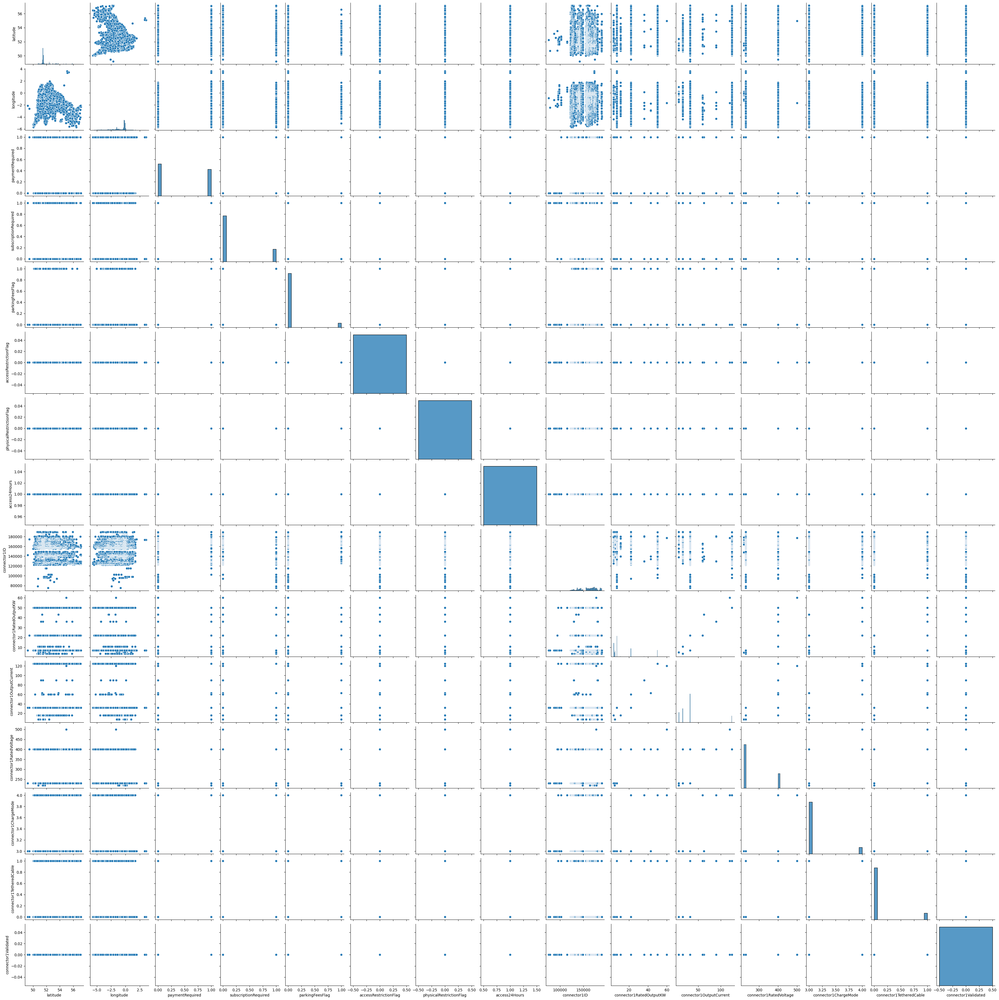

In [30]:
sns.pairplot(df3.loc[:,(df3.dtypes == "float64")])

In [32]:
h = df3["county"].groupby(df3['county']).count()
h.shape

(320,)

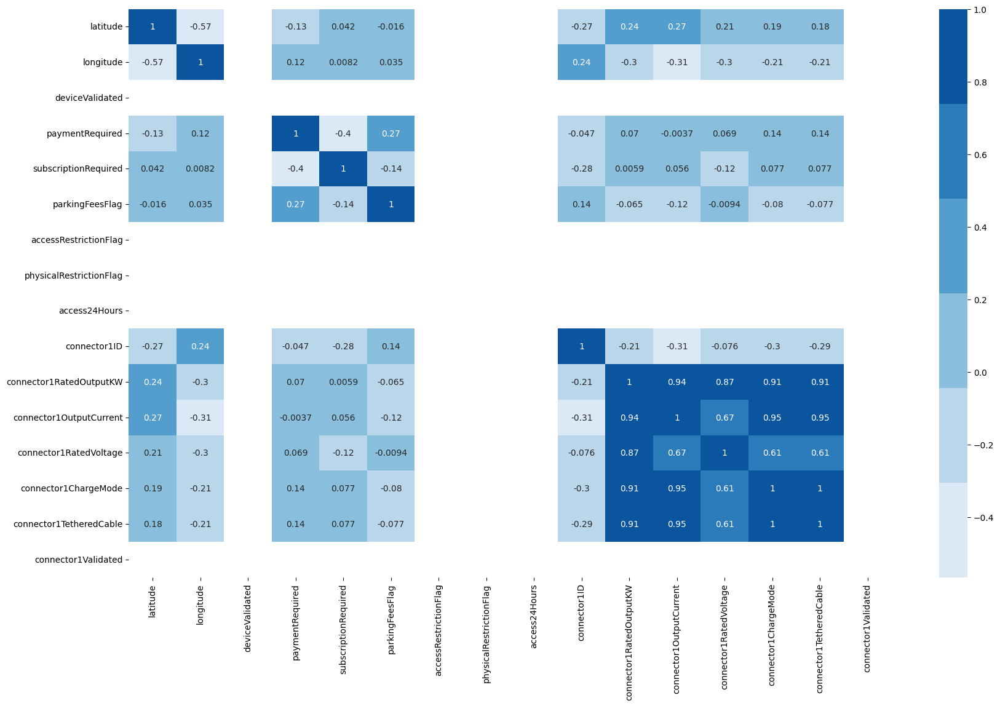

In [60]:
plt.figure(figsize=(20,12))
colormap = sns.color_palette("Blues")
sns.heatmap(df3.loc[:,(df3.dtypes == "float64")|(df3.dtypes == "int64")].corr(), cmap=colormap, annot = True)
plt.show()

In [33]:
from sklearn.feature_selection import RFE
from sklearn.decomposition import PCA
from sklearn.tree import DecisionTreeClassifier
from sklearn.preprocessing import LabelEncoder


target_variable = 'chargeDeviceStatus'


numerical_cols = ['latitude', 'longitude', 'connector1RatedOutputKW', 'connector1OutputCurrent',
                  'connector1RatedVoltage']



In [34]:
label_encoder = LabelEncoder()
encoded_categorical_cols = []
for col in string_cols:
    df3[col] = label_encoder.fit_transform(df3[col])
    encoded_categorical_cols.append(col)


<ipython-input-34-103133e5527e>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df3[col] = label_encoder.fit_transform(df3[col])
<ipython-input-34-103133e5527e>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df3[col] = label_encoder.fit_transform(df3[col])
<ipython-input-34-103133e5527e>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pand

In [35]:
selected_cols = numerical_cols + encoded_categorical_cols

In [36]:
estimator = DecisionTreeClassifier()  # Choose your desired estimator
rfe_selector = RFE(estimator, n_features_to_select=10)  # Selecting top 10 features
X = df3[selected_cols]
y = df3[target_variable]
rfe_selector.fit(X, y)
rfe_selected_features = X.columns[rfe_selector.support_]
print("Selected Features (RFE):")
print(rfe_selected_features)

Selected Features (RFE):
Index(['chargeDeviceStatus', 'publishStatus', 'dateCreated', 'dateUpdated',
       'moderated', 'attribution', 'locationType', 'connector1Type',
       'connector1ChargeMethod', 'connector1Status'],
      dtype='object')


In [37]:
pca = PCA(n_components=10)
X_pca = pca.fit_transform(X)
print(X_pca)

[[-6.53705618e+02  6.11493914e+03 -1.20655273e+03 ... -3.96031381e+01
  -7.99413932e+01  1.08596831e+01]
 [ 2.46115381e+02 -9.50014206e+03 -4.25788566e+03 ...  5.05138278e+01
   6.62734612e+01  1.69374428e+02]
 [-2.65336665e+02  7.60696294e+03 -4.12048978e+03 ...  5.02691200e+01
   6.59027664e+01  1.68927841e+02]
 ...
 [ 6.76960257e+02  1.08480340e+04  1.16067186e+04 ...  8.83410741e+01
  -6.30995163e+01 -7.20830588e+01]
 [ 1.58117734e+04 -8.82465368e+03  1.97073607e+03 ...  1.77874348e+02
   6.65298071e+01  1.77644561e+02]
 [ 1.02625467e+04  1.10830375e+03  8.06915458e+02 ...  1.85313215e+02
   5.48396485e+01  1.69812292e+02]]


Let's have a look at the values in our target column

In [38]:
df3["connector1Status"].groupby(df3["connector1Status"]).count()

connector1Status
0    26949
1       55
2       66
Name: connector1Status, dtype: int64

Since we have the prediction  columns values with a very imbalanced proportion so we have to balance the values to get the better results from our model

before proceeding to towards balancing the target columns we need to get the data into another dataframe so that we didn't bother getting into another problem and work with it easily

using smote

In [42]:
from imblearn.over_sampling import SMOTE



In [43]:
X = df3[rfe_selected_features]
X.drop("connector1Status",inplace = True , axis = 1)
y = df3['connector1Status']
smote = SMOTE()

<ipython-input-43-dc06b532903e>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X.drop("connector1Status",inplace = True , axis = 1)


In [44]:
X_balanced, y_balanced = smote.fit_resample(X, y)

In [45]:
df_balanced = pd.DataFrame(X_balanced, columns=X.columns)
df_balanced['connector1Status'] = y_balanced

In [46]:
df_balanced.shape

(80847, 10)

In [47]:
df_balanced["connector1Status"].groupby(df_balanced["connector1Status"]).count()

connector1Status
0    26949
1    26949
2    26949
Name: connector1Status, dtype: int64

Let's begin training our models


In [62]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report
from sklearn.metrics import accuracy_score, mean_squared_error

In [58]:
X_train, X_test, y_train, y_test = train_test_split(X_balanced, y_balanced, test_size=0.2, random_state=42)

logreg = LogisticRegression()

logreg.fit(X_train, y_train)

y_pred_logreg = logreg.predict(X_test)

print("Logistic Regression:")
print(classification_report(y_test, y_pred_logreg))


Logistic Regression:
              precision    recall  f1-score   support

           0       0.81      0.70      0.75      5345
           1       0.82      0.61      0.70      5483
           2       0.70      0.98      0.82      5342

    accuracy                           0.76     16170
   macro avg       0.78      0.77      0.76     16170
weighted avg       0.78      0.76      0.76     16170



/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [59]:
dt = DecisionTreeClassifier()

dt.fit(X_train, y_train)

y_pred_dt = dt.predict(X_test)

print("Decision Tree:")
print(classification_report(y_test, y_pred_dt))


Decision Tree:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      5345
           1       1.00      1.00      1.00      5483
           2       1.00      1.00      1.00      5342

    accuracy                           1.00     16170
   macro avg       1.00      1.00      1.00     16170
weighted avg       1.00      1.00      1.00     16170



In [60]:
rf = RandomForestClassifier()

rf.fit(X_train, y_train)

y_pred_rf = rf.predict(X_test)

print("Random Forest:")
print(classification_report(y_test, y_pred_rf))

Random Forest:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      5345
           1       1.00      1.00      1.00      5483
           2       1.00      1.00      1.00      5342

    accuracy                           1.00     16170
   macro avg       1.00      1.00      1.00     16170
weighted avg       1.00      1.00      1.00     16170



Since we have a very accurate score with the use of the Decision trees and Random forests so there is no need to proceed further hence we have our desired model. Therefore the comparison chart of the accuracy is as follows  

<function matplotlib.pyplot.show(close=None, block=None)>

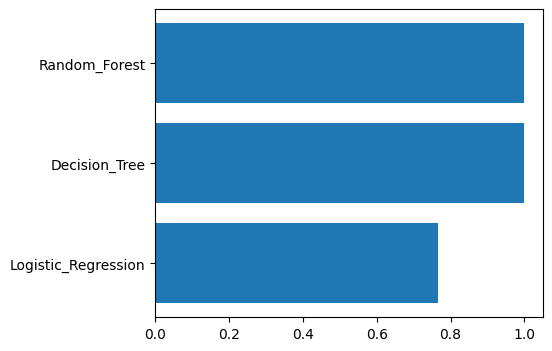

In [71]:
accuracy = [accuracy_score(y_test, y_pred_logreg), accuracy_score(y_test, y_pred_dt), accuracy_score(y_test, y_pred_rf)]
mse = [mean_squared_error(y_test, y_pred_logreg), mean_squared_error(y_test, y_pred_dt), mean_squared_error(y_test, y_pred_rf)]
models = ["Logistic_Regression" , "Decision_Tree" , "Random_Forest"]
plt.figure(figsize = (5,4))
plt.barh(models,accuracy)
plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

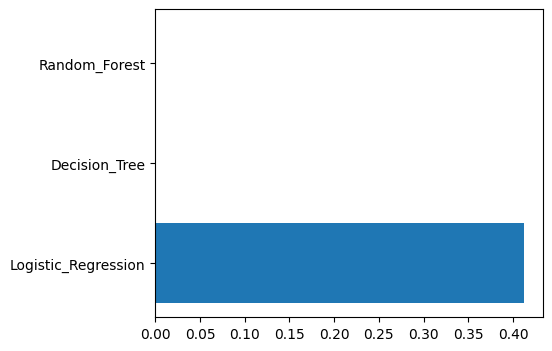

In [72]:
plt.figure(figsize = (5,4))
plt.barh(models,mse)
plt.show

Predicted Data is as Follows:

In [74]:
dict_a = {
    models[0]  : y_pred_logreg,
    models[1]  : y_pred_dt,
    models[2]  : y_pred_rf
    }

pridicted_df = pd.DataFrame(dict_a)


In [75]:
pridicted_df.head()

,Logistic_Regression,Decision_Tree,Random_Forest
0,0,0,0
1,0,0,0
2,2,2,2
3,0,1,1
4,2,0,0
